# Customer Segmentation of Credit Card

## Introduction of credit card data set

This data set was obtained from Kaggle. It summarizes the usage behavior of about 8950 active credit card holders during the last 6 months.  The data set is at a customer level with 18 behavioral variables. 

The following description gives the 18 variables info in the credit card data set which were provided by Kaggle:
  *	CUST_ID: Identification of Credit Card holder (Categorical); 
  *	BALANCE : Balance amount left in their account to make purchases; 
  *	BALANCE_FREQUENCY : How frequently the Balance is updated, score between 0 and 1 (1 = frequently updated, 0 = not frequently updated); 
  *	PURCHASES : Amount of purchases made from account;
  * ONEOFF_PURCHASES : Maximum purchase amount done in one-go; 
  * INSTALLMENTS_PURCHASES : Amount of purchase done in installment; 
  * CASH_ADVANCE : Cash in advance given by the user;
  * PURCHASES_FREQUENCY : How frequently the Purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased); 
  *	ONEOFFPURCHASESFREQUENCY : How frequently Purchases are happening in one-go (1 = frequently purchased, 0 = not frequently   urchased);
  * PURCHASESINSTALLMENTSFREQUENCY : How frequently purchases in installments are being done (1 = frequently done, 0 = not frequently done);
  * CASHADVANCEFREQUENCY : How frequently the cash in advance being paid; 
  * CASHADVANCETRX : Number of Transactions made with "Cash in Advanced"; 
  * PURCHASES_TRX : Number of purchase transactions made; 
  * CREDIT_LIMIT : Limit of Credit Card for user; 
  * PAYMENTS : Amount of Payment done by user; 
  * MINIMUM_PAYMENTS : Minimum amount of payments made by user; 
  * PRCFULLPAYMENT : Percent of full payment paid by user.
  * TENURE : Tenure of credit card service for user

### Objectives of this project:

In this project, the first objective is to use clustering models to develop customer segmentation and then make marketing strategies. The second is to select the best clustering model through tuning hyper parameters.

Now let's take a look this credit card data set.

## Load data

In [52]:
import pandas as pd
import numpy as np
import scipy
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn import datasets, metrics
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.manifold import TSNE
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.mixture import GaussianMixture
import time
import warnings
import matplotlib.pyplot as plt
sns.set()

In [53]:
creditcard_raw_df = pd.read_csv('CC GENERAL.csv')
creditcard_raw_df.head(10)

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
5,C10006,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0,8,1800.0,1400.057770,2407.246035,0.000000,12
6,C10007,627.260806,1.000000,7091.01,6402.63,688.38,0.000000,1.000000,1.000000,1.000000,0.000000,0,64,13500.0,6354.314328,198.065894,1.000000,12
7,C10008,1823.652743,1.000000,436.20,0.00,436.20,0.000000,1.000000,0.000000,1.000000,0.000000,0,12,2300.0,679.065082,532.033990,0.000000,12
8,C10009,1014.926473,1.000000,861.49,661.49,200.00,0.000000,0.333333,0.083333,0.250000,0.000000,0,5,7000.0,688.278568,311.963409,0.000000,12
9,C10010,152.225975,0.545455,1281.60,1281.60,0.00,0.000000,0.166667,0.166667,0.000000,0.000000,0,3,11000.0,1164.770591,100.302262,0.000000,12


## Explore the data

In [54]:
creditcard_raw_df.shape

(8950, 18)

This credit card data set has 8950 rows and 18 columns.

In [55]:
creditcard_raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
CUST_ID                             8950 non-null object
BALANCE                             8950 non-null float64
BALANCE_FREQUENCY                   8950 non-null float64
PURCHASES                           8950 non-null float64
ONEOFF_PURCHASES                    8950 non-null float64
INSTALLMENTS_PURCHASES              8950 non-null float64
CASH_ADVANCE                        8950 non-null float64
PURCHASES_FREQUENCY                 8950 non-null float64
ONEOFF_PURCHASES_FREQUENCY          8950 non-null float64
PURCHASES_INSTALLMENTS_FREQUENCY    8950 non-null float64
CASH_ADVANCE_FREQUENCY              8950 non-null float64
CASH_ADVANCE_TRX                    8950 non-null int64
PURCHASES_TRX                       8950 non-null int64
CREDIT_LIMIT                        8949 non-null float64
PAYMENTS                            8950 non-null float64
MINIMUM_PAYMENTS            

In [56]:
creditcard_raw_df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


### Explore Missing values

In [57]:
creditcard_raw_df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

It can be seen from the above results that this data set has missing values-313 missing in 'MINIMUM_PAYMENTS' column and 1 in 'CREDIT_LIMIT'column. Also, there have many outliers which are very big or large maxium values and seems not reasonable for credit card use.

### Detect outliers

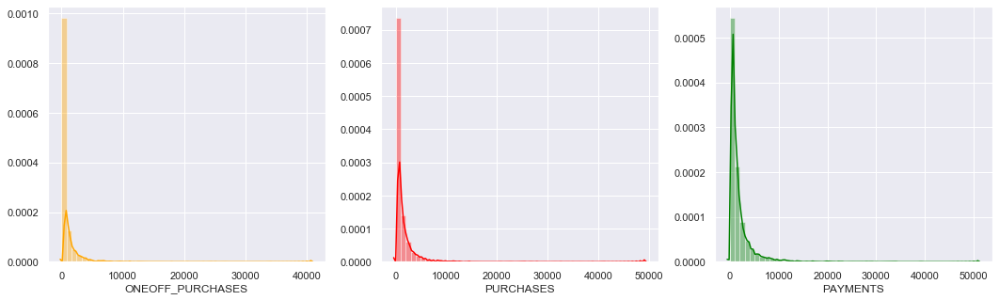

In [58]:
plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)
sns.distplot(creditcard_raw_df['ONEOFF_PURCHASES'], color = 'orange')

plt.subplot(1, 3, 2)
sns.distplot(creditcard_raw_df['PURCHASES'], color = 'red')

plt.subplot(1, 3, 3)
sns.distplot(creditcard_raw_df['PAYMENTS'], color = 'green')

### Dealing with missing values and outliers

1. Outliers

To keep this data set size, so mean value is used for replacing 314 missing values. And outliers are replaced by setting the maximum at reasonable values instead of dropping some of extreme large values.

In [59]:
import warnings
warnings.filterwarnings('ignore')
creditcard_raw_df.PURCHASES[creditcard_raw_df.PURCHASES>=10000]= 10000

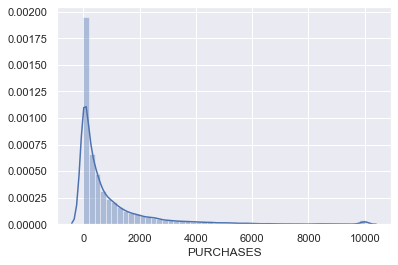

In [60]:
sns.distplot(creditcard_raw_df['PURCHASES'])

In [61]:
creditcard_raw_df['PURCHASES'].describe()

count     8950.000000
mean       945.329571
std       1575.240358
min          0.000000
25%         39.635000
50%        361.280000
75%       1110.130000
max      10000.000000
Name: PURCHASES, dtype: float64

In [62]:
creditcard_raw_df.ONEOFF_PURCHASES[creditcard_raw_df.ONEOFF_PURCHASES>10000]= 6000

In [63]:
creditcard_raw_df['ONEOFF_PURCHASES'].describe()

count    8950.000000
mean      540.539882
std      1126.673896
min         0.000000
25%         0.000000
50%        38.000000
75%       577.405000
max      9849.050000
Name: ONEOFF_PURCHASES, dtype: float64

In [64]:
creditcard_raw_df.INSTALLMENTS_PURCHASES[creditcard_raw_df.INSTALLMENTS_PURCHASES>10000]= 6000
creditcard_raw_df.CASH_ADVANCE[creditcard_raw_df.CASH_ADVANCE>=5000]= 4000
creditcard_raw_df.CREDIT_LIMIT[creditcard_raw_df.CREDIT_LIMIT>=10000]= 10000
creditcard_raw_df.PAYMENTS[creditcard_raw_df.PAYMENTS>=10000]= 10000
creditcard_raw_df.MINIMUM_PAYMENTS[creditcard_raw_df.MINIMUM_PAYMENTS>=10000]= 3000

creditcard_raw_df.CASH_ADVANCE_TRX[creditcard_raw_df.CASH_ADVANCE_TRX>=50]=50
creditcard_raw_df.PURCHASES_TRX[creditcard_raw_df.PURCHASES_TRX>=50]= 50

In [65]:
creditcard_df = creditcard_raw_df
creditcard_df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,945.329571,540.539882,401.025142,789.974557,0.490351,0.202458,0.364437,0.135144,3.190168,12.296425,4228.816419,1600.426525,714.026846,0.153715,11.517318
std,2081.531879,0.236904,1575.240358,1126.673896,786.084347,1276.639710,0.401371,0.298336,0.397448,0.200121,6.168567,14.659157,2948.088850,2023.205271,1037.811148,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,10000.000000,9849.050000,9268.320000,4968.817936,1.000000,1.000000,1.000000,1.500000,50.000000,50.000000,10000.000000,10000.000000,9957.742740,1.000000,12.000000


2. Missing values

In [66]:
creditcard_df['MINIMUM_PAYMENTS'] = creditcard_df['MINIMUM_PAYMENTS'].fillna(creditcard_df['MINIMUM_PAYMENTS'].mean())

In [67]:
creditcard_df['MINIMUM_PAYMENTS'].isnull().sum()

0

In [68]:
creditcard_df['MINIMUM_PAYMENTS'].describe()

count    8950.000000
mean      714.026846
std      1019.500385
min         0.019163
25%       170.857654
50%       335.628312
75%       788.713501
max      9957.742740
Name: MINIMUM_PAYMENTS, dtype: float64

In [69]:
creditcard_df['CREDIT_LIMIT'] = creditcard_df['CREDIT_LIMIT'].fillna(creditcard_df['CREDIT_LIMIT'].mean())

In [70]:
creditcard_df['CREDIT_LIMIT'].describe()

count     8950.000000
mean      4228.816419
std       2947.924129
min         50.000000
25%       1600.000000
50%       3000.000000
75%       6500.000000
max      10000.000000
Name: CREDIT_LIMIT, dtype: float64

## Build Model

In this capstone, K_means, Hierarchical and Gaussian Mixture Models (GMM) are applied for clustering data.

## K-means

In [71]:
# Define variables

X = creditcard_df.drop(['CUST_ID'],axis=1)

In [72]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

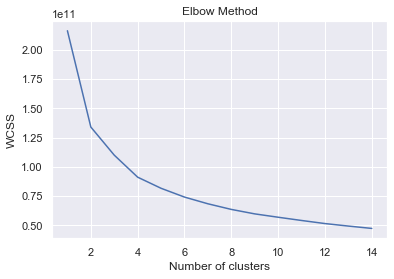

In [73]:
# Use inertia to find clusters K
from sklearn.cluster import KMeans

wcss = []
for i in range(1, 15):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1, 15), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [74]:
# Defining the k-means
km = KMeans(n_clusters=3, random_state=50)

# Fit model
%timeit km.fit(X_std)
labels = km.predict(X_std)

300 ms ± 43 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


## Visualize model using PCA

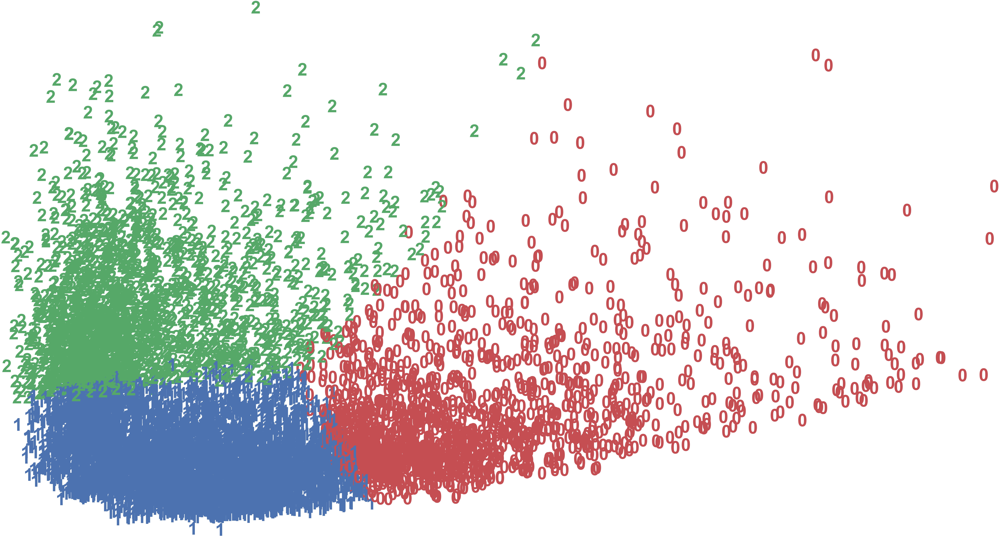

In [75]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2).fit_transform(X_std)

plt.figure(figsize=(10,6))
colours = 'rbgkcm'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(labels[i]),
             color=colours[labels[i]],
             fontdict={'weight': 'bold', 'size': 150}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [76]:
# Calculate the variance for PCA
pca = PCA(n_components=3).fit(X_std)

print('The percentage of total variance in the dataset explained by each',
    'component from Sklearn PCA.\n',
    pca.explained_variance_ratio_)

The percentage of total variance in the dataset explained by each component from Sklearn PCA.
 [0.29226864 0.22136612 0.08569906]


## Evaluate clusters

In [77]:
from sklearn import datasets, metrics
from sklearn.metrics import silhouette_samples, silhouette_score
# The data has no ground truth
# Silhouette score is used to evaluate clusters.

labels = KMeans(n_clusters=3, random_state=50).fit_predict(X_std)
print("The silhoutte score of the K-means Clustering solution: {}"
      .format(silhouette_score(X_std, labels, metric='euclidean')))

The silhoutte score of the K-means Clustering solution: 0.2438070897078514


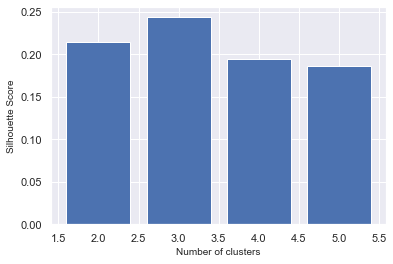

In [78]:
# Compare silhouette scores for different clusters number.

silhouette_scores = [] 

for i in range(2,6):
    labels = KMeans(n_clusters=i, random_state=50).fit_predict(X_std)
    silhouette_scores.append( 
        silhouette_score(X_std, labels, metric='euclidean')) 
    
# Plotting a bar graph to compare the results 
k = [2, 3, 4, 5] 
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Silhouette Score', fontsize = 10) 
plt.show() 

From the above figure, the case of n_clusters=3 has highest silhouette score about 0.244.

### Plot silhouette score with various clusters

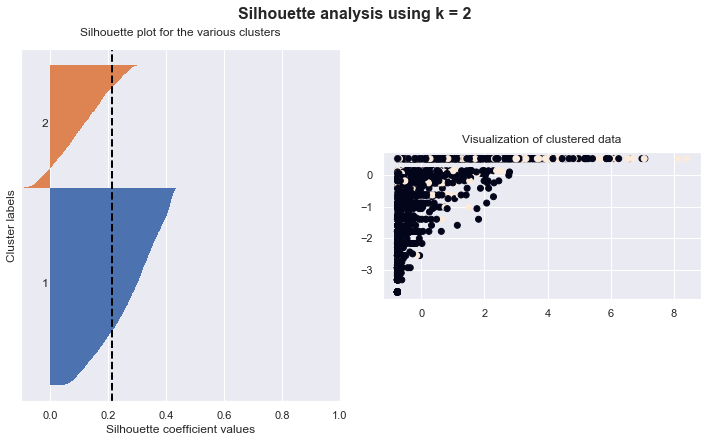

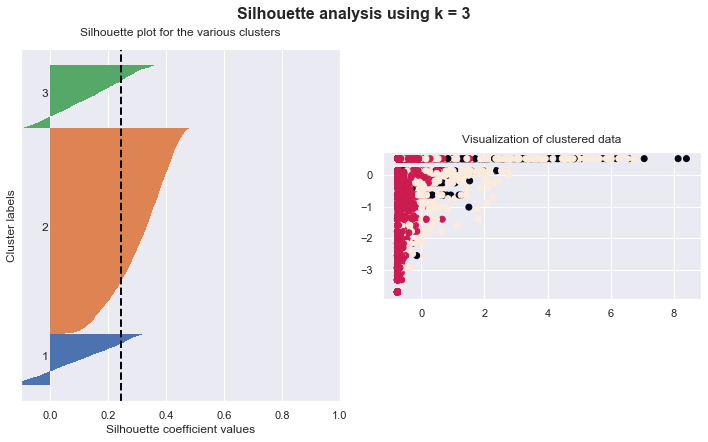

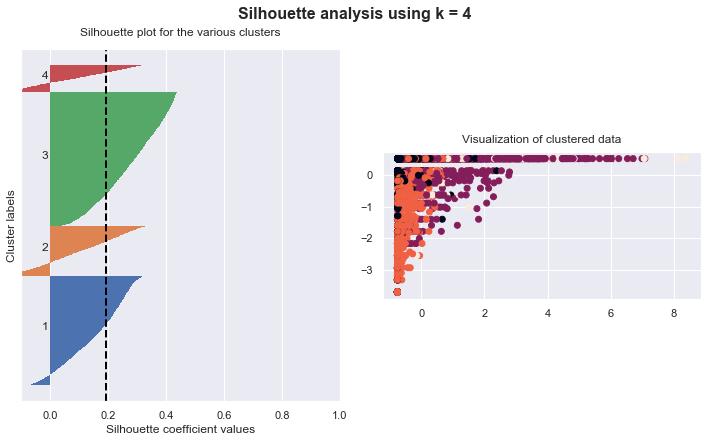

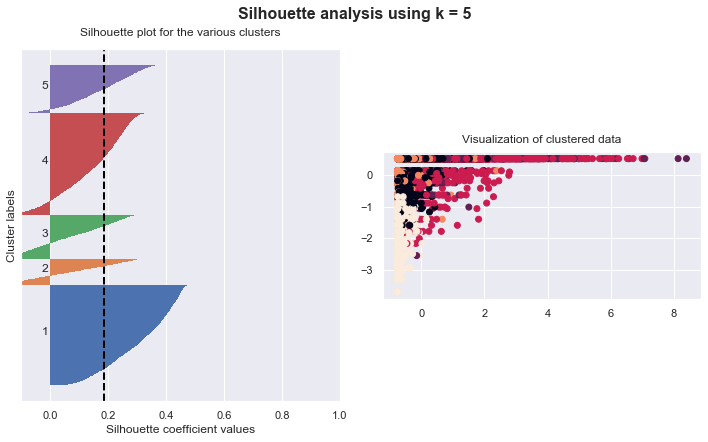

In [79]:
# Plot silhouette score with various clusters
for i, k in enumerate([2, 3, 4, 5]):
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(10, 6)
    
    # Run the Kmeans algorithm
    km = KMeans(n_clusters=k)
    labels = km.fit_predict(X_std)
   
    # Get silhouette samples
    silhouette_vals = silhouette_samples(X_std, labels)

    # Silhouette plot
    y_ticks = []
    y_lower, y_upper = 0, 0
    for i, cluster in enumerate(np.unique(labels)):
        cluster_silhouette_vals = silhouette_vals[labels == cluster]
        cluster_silhouette_vals.sort()
        y_upper += len(cluster_silhouette_vals)
        ax1.barh(range(y_lower, y_upper), cluster_silhouette_vals, edgecolor='none', height=1)
        ax1.text(-0.03, (y_lower + y_upper) / 2, str(i + 1))
        y_lower += len(cluster_silhouette_vals)

    # Get the average silhouette score and plot it
    avg_score = np.mean(silhouette_vals)
    ax1.axvline(avg_score, linestyle='--', linewidth=2, color='black')
    ax1.set_yticks([])
    ax1.set_xlim([-0.1, 1])
    ax1.set_xlabel('Silhouette coefficient values')
    ax1.set_ylabel('Cluster labels')
    ax1.set_title('Silhouette plot for the various clusters', y=1.02);
    
    # Scatter plot of data colored with labels
    ax2.scatter(X_std[:, 0], X_std[:, 1], c=labels)
    
         
    ax2.set_title('Visualization of clustered data', y=1.02)
    ax2.set_aspect('equal')
    plt.tight_layout()
    plt.suptitle(f'Silhouette analysis using k = {k}',
                 fontsize=16, fontweight='semibold', y=1.02)
    plt.show()

As the above silhouette analysis plots show, n_clusters=3 has the best average silhouette score of around 0.244. The scores for n_clusters=2, 4, 5 are about 0.214, 0.194, 0.186, respectively. Silhouette scores increased from 2 to 3 clusters and then decreased from 3 to 4 and 5 clusters. It seems clusters equal to 3 is the best choice for fitting model. Further, the thickness of the silhouette plot gives an indication of how big each cluster is. It can be seen from the figure of K=3 case that cluster 3 has much more samples compared with cluster 1 and 2. Both cluster 1 and 2 have similar samples. 

The bottom line for silhouette score is: Good n_clusters will have a well above 0.5 silhouette average score as well as all of the clusters have higher than the average score. However, in this credit card case, the highest silhouette score is obtained about 0.24 for n_clusters=3 cases. It is obviously less than 0.5 and the model seems not very good fitting and subgroups are overlapped as also seen in the both PCA plot and "Visualization of clustered data" plots. 

Although K_means clustering has a slightly low silhouette score and does not group datapoints into distinct non-overlapping subgroups, it still can give you some idea to the structure of the dataset. Now let's implement the K-means clusters using K=3 case with the highest silhouette score of 0.244.

## Implement K-means Clusters

In [80]:
# Define a new column to take a look what each cluster represents(K=3 case).
labels_3 = KMeans(n_clusters=3, random_state=50).fit_predict(X_std)
creditcard_df['Prediction']= labels_3
creditcard_df.groupby("Prediction").mean()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
Prediction,,,,,,,,,,,,,,,,,
0,2123.332766,0.980033,3600.732624,2188.511680,1387.579532,408.593279,0.936305,0.630789,0.729917,0.067731,1.644628,37.705234,6499.001377,3421.396956,927.984284,0.278811,11.898072
1,743.753567,0.829243,461.502403,225.999862,235.848413,269.473420,0.458957,0.125044,0.340734,0.064907,1.122321,8.140268,3113.397061,827.207394,455.147415,0.158256,11.467852
2,3780.880505,0.949141,331.934963,206.423974,125.568789,2803.005621,0.224654,0.101457,0.140081,0.419950,11.212621,4.882319,5994.071184,2620.014658,1382.044388,0.035636,11.364412


In [81]:
creditcard_df.groupby("Prediction").describe()

BALANCE                                                   \
             count         mean          std       min          25%   
Prediction                                                            
0           1452.0  2123.332766  2477.708333  1.632453   353.720894   
1           5739.0   743.753567   904.576903  0.000000    50.814144   
2           1759.0  3780.880505  2635.507542  8.640998  1743.392841   

                                                   BALANCE_FREQUENCY  \
                    50%          75%           max             count   
Prediction                                                             
0           1192.646568  3006.370216  19043.138560            1452.0   
1            366.688990  1172.264064   5901.592192            5739.0   
2           3168.902659  5339.546045  16304.889250            1759.0   

                      ... PRC_FULL_PAYMENT       TENURE                       \
                mean  ...              75%  max   count       mean       std   
Prediction            ...                                                      
0           0.980033  ...         0.574405  1.0  1452.0  11.898072  0.616181   
1           0.829243  ...         0.166667  1.0  5739.0  11.467852  1.400892   
2           0.949141  ...         0.000000  1.0  1759.0  11.364412  1.499225   

                                         
            min   25%   50%   75%   max  
Prediction                               
0           6.0  12.0  12.0  12.0  12.0  
1           6.0  12.0  12.0  12.0  12.0  
2           6.0  12.0  12.0  12.0  12.0  

[3 rows x 136 columns]

In [82]:
# Calculate the percentage for each group.
groupsize = creditcard_df['Prediction'].value_counts()/creditcard_df.shape[0]*100
groupsize

1    64.122905
2    19.653631
0    16.223464
Name: Prediction, dtype: float64

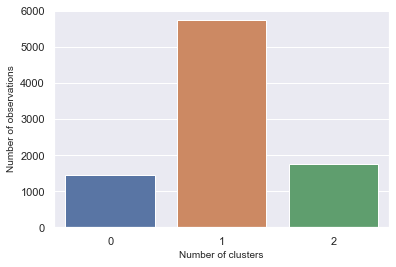

In [83]:
# Count the observations in each cluster
sns.countplot(x='Prediction',data=creditcard_df)
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Number of observations', fontsize = 10)
plt.show()

From the above graph, cluster 1 has more observations compared with cluster 0 and 2. The observations for Cluster 0 and 2 are close.

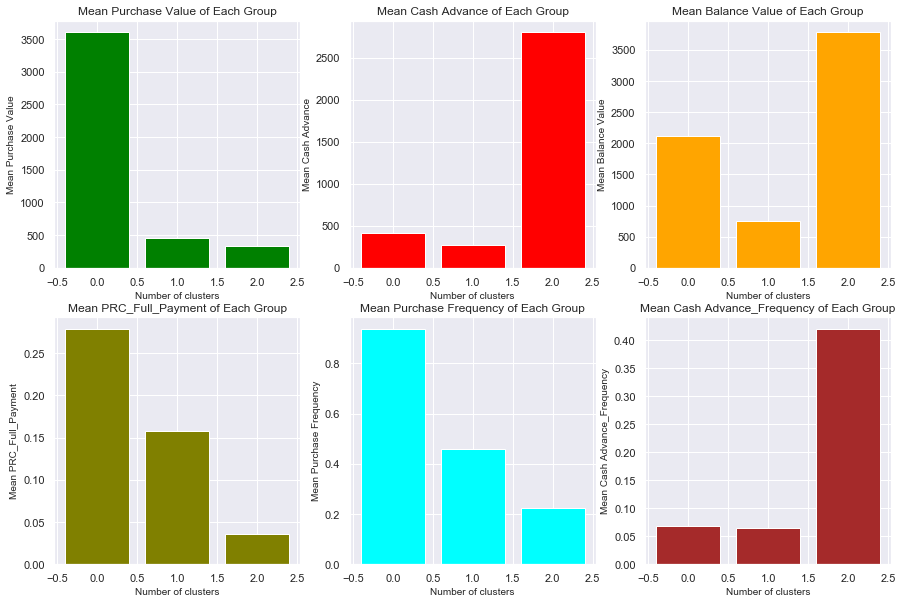

In [84]:
# Plot six variables with three clusters as examples and perform comparison for three clusters.

Y_purchase = creditcard_df.groupby("Prediction").PURCHASES.mean()
Y_balance = creditcard_df.groupby("Prediction").BALANCE.mean()
Y_cash = creditcard_df.groupby("Prediction").CASH_ADVANCE.mean()
Y_prc_pay = creditcard_df.groupby("Prediction").PRC_FULL_PAYMENT.mean()
Y_pur_fr = creditcard_df.groupby("Prediction").PURCHASES_FREQUENCY.mean()
Y_cash_fr =creditcard_df.groupby("Prediction").CASH_ADVANCE_FREQUENCY.mean()


k =[0, 1, 2]

plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.bar(k, Y_purchase, color='green')
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Mean Purchase Value', fontsize = 10) 
plt.title("Mean Purchase Value of Each Group")

plt.subplot(2, 3, 2)
plt.bar(k, Y_cash, color='red')
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Mean Cash Advance', fontsize = 10) 
plt.title("Mean Cash Advance of Each Group")

plt.subplot(2, 3, 3)
plt.bar(k, Y_balance, color='orange')
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Mean Balance Value', fontsize = 10) 
plt.title("Mean Balance Value of Each Group")

plt.subplot(2, 3, 4)
plt.bar(k, Y_prc_pay, color='olive')
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Mean PRC_Full_Payment', fontsize = 10) 
plt.title("Mean PRC_Full_Payment of Each Group")

plt.subplot(2, 3, 5)
plt.bar(k, Y_pur_fr, color='cyan')
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Mean Purchase Frequency', fontsize = 10) 
plt.title("Mean Purchase Frequency of Each Group")

plt.subplot(2, 3, 6)
plt.bar(k, Y_cash_fr, color='brown')
plt.xlabel('Number of clusters', fontsize = 10) 
plt.ylabel('Mean Cash Advance_Frequency', fontsize = 10) 
plt.title("Mean Cash Advance_Frequency of Each Group")

plt.show() 

In the above figure, the mean purchase, purchase frequency and balance are plotted with number of clusters. Based on the purchase, cash advance and balance conditions, we can divide the credit card customers into 3 groups and give the names for each group.

Group 0 has the largest mean purchase value and purchase frequency，so we can name this group as "Purchase_like group".

Group 2 has the highest mean cash advance and balance value and very small percentage of full payment, their name could be "Cash_advance_like group".

Group 1 is has the huge observations, and they have smallest balance in their account and they spend more money and has a little bit more purchase frequency than group 2. Hence, they should be called as "Economical_like group".

For group 2, "Cash_advance_like group", credit card company can make more money from these group customers by charging them cash advance fee, ATM or bank fees, or interest. The interest for cash advance is often much higher than the rate charged on purchases. This group size accounts for about 20%. The company should keep this group customers, for example, providing them a little bit high credit limit about 6000 (as shown in the data table) or capping cash advances at a slight high amount to encourage them to do cash advance. However, the credit card company also need keep an eye on them because they usually pay very less amount of full payment about 4% as shown in the above graph. In other words, cash advances, a kind of short-term loan, also take risk of losing money for the credit card company due to customers' financial crisis.

"Purchase_like group" or group 0 (group size 16%) is also a group to make profit for credit card company. For instance, Intercharge fee from merchants is a big reason you usually can see creditors fighting for advertisements and promotions. The credit card company encourages you-credit card holder in some way to use your card more often because they can make a good amount of money every time you swipe your card. Hence, customers in this group is worth for the compant doing promotions for them such as cash back bonus, reward points and so on to keep them and continue to use the credit card to purchase more often. In addition, customers in this group have good reputation. As can be seen in the above graph, they make good payment and have highest percentage for full payment about 28%. This definitely decreases the bad debt risk the company would take.

"Economical_like group" (group 1) with the most observations (group size 64%) is the group which the credit card company need to pay more attention and make strategies. The company may provide them more promotions, for example, increasing their credit card limit, or giving them unlimit 2% cash back on all purchases, or increasing reward points etc., to let them to use their credit card more often and move them close to or in "Purchase_like group". Further, the company can provide them slight low interest to encourage them to do cash_advance with cautiouness and let them to move close to or in "Cash_advance_like group". More populations spread into either "Purchase_like group" or "Cash_advance_like group", more profit the credit card company could make.

In all, the k-means clustering model provides very good and explanatory information for this dataset. The credit card company can gain insight and make marketing strategies based on this dataset analysis.

## Dimension Reduction with t-SNE

In [85]:
import time
from sklearn.manifold import TSNE

X1 = creditcard_df.drop(['CUST_ID'],axis=1)
scaler = StandardScaler()
X1_std = scaler.fit_transform(X1)

# Fit model
km = KMeans(n_clusters=3, random_state=50)
km.fit(X1_std)
labels_t= km.predict(X1_std)

time_start = time.time()
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(X1_std)

print('t-SNE done! Time elapsed: {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 8950 samples in 0.020s...
[t-SNE] Computed neighbors for 8950 samples in 2.318s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8950
[t-SNE] Computed conditional probabilities for sample 2000 / 8950
[t-SNE] Computed conditional probabilities for sample 3000 / 8950
[t-SNE] Computed conditional probabilities for sample 4000 / 8950
[t-SNE] Computed conditional probabilities for sample 5000 / 8950
[t-SNE] Computed conditional probabilities for sample 6000 / 8950
[t-SNE] Computed conditional probabilities for sample 7000 / 8950
[t-SNE] Computed conditional probabilities for sample 8000 / 8950
[t-SNE] Computed conditional probabilities for sample 8950 / 8950
[t-SNE] Mean sigma: 0.560384
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.405151
[t-SNE] KL divergence after 300 iterations: 2.486516
t-SNE done! Time elapsed: 41.12230181694031 seconds


In [86]:
plt.figure(figsize=(10,5))
colours = 'rbgkyc'
for i in range(tsne_results.shape[0]):
    plt.text(tsne_results[i, 0], tsne_results[i, 1], str(labels_t[i]),
             color=colours[labels_t[i]],
             fontdict={'weight': 'bold', 'size': 150}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

Compare t-SNE visualization with PCA(n_cluster=3 case), dimension reduction with t-SNE is clearly much better than PCA with very less overlapping problem for seperating the datapoints into different groups. 

## Hierarchical clustering

In [87]:
# Let's try Hierarchical clustering model with K=3
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

X2 = creditcard_df.drop(['CUST_ID'],axis=1)

scaler = StandardScaler()
X2_std = scaler.fit_transform(X2)

# Defining the agglomerative clustering
agg_cluster = AgglomerativeClustering(linkage='complete', 
                                      affinity='cosine',
                                      n_clusters=3)

# Fit model
clusters_h = agg_cluster.fit_predict(X2_std)

print("The silhoutte score of the Agglomerative Clustering solution: {}"
      .format(metrics.silhouette_score(X2_std, clusters_h, metric='euclidean')))

The silhoutte score of the Agglomerative Clustering solution: 0.16185301566562452


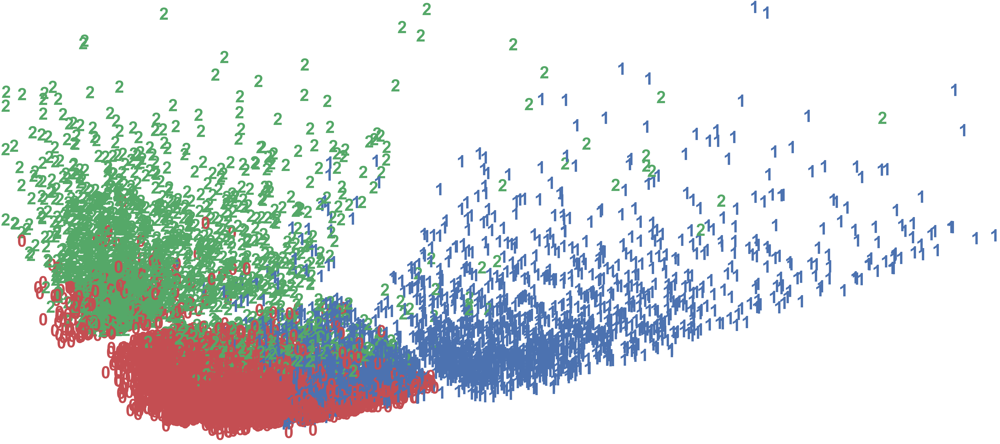

In [88]:
# Use PCA to visualize the model
pca = PCA(n_components=2).fit_transform(X2_std)

plt.figure(figsize=(10,5))
colours = 'rbgkyc'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters_h[i]),
             color=colours[clusters_h[i]],
             fontdict={'weight': 'bold', 'size': 150}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [89]:
# Calculate the variance for PCA
pca_h = PCA(n_components=3).fit(X2_std)

print('The percentage of total variance in the dataset explained by each',
    'component from Sklearn PCA.\n',
    pca_h.explained_variance_ratio_)

The percentage of total variance in the dataset explained by each component from Sklearn PCA.
 [0.30601173 0.21753247 0.08172267]


The Hierarchical silhoutte score (0.16) is lower than K-means (0.24). Three groups are cleanly seen through PCA visualization but with more overlapping datapoints.

## Gaussian Mixture Models (GMM)

In [90]:
# Let's take a look GMM with K=3

from sklearn.mixture import GaussianMixture

X2 = creditcard_df.drop(['CUST_ID'],axis=1)

scaler = StandardScaler()
X2_std = scaler.fit_transform(X2)

# Defining the agglomerative clustering
gmm_cluster = GaussianMixture(n_components=3, covariance_type='full',max_iter=150, random_state=50)

# Fit model
clusters_g = gmm_cluster.fit_predict(X2_std)

print("The silhoutte score of the GMM solution: {}"
      .format(metrics.silhouette_score(X2_std, clusters_g, metric='euclidean')))

The silhoutte score of the GMM solution: 0.27854564069997484


In [91]:
# Use PCA to visualize the model
pca = PCA(n_components=2).fit_transform(X2_std)

plt.figure(figsize=(20,15))
colours = 'rbgkyc'
for i in range(pca.shape[0]):
    plt.text(pca[i, 0], pca[i, 1], str(clusters_g[i]),
             color=colours[clusters_g[i]],
             fontdict={'weight': 'bold', 'size': 150}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

In [92]:
# Calculate the variance for PCA
pca_g = PCA(n_components=3).fit(X2_std)

print('The percentage of total variance in the dataset explained by each',
    'component from Sklearn PCA.\n',
    pca_g.explained_variance_ratio_)

The percentage of total variance in the dataset explained by each component from Sklearn PCA.
 [0.30601173 0.21753247 0.08172267]


The silhoutte score (0.28) is slightly higher than K-means (0.24). Three groups are cleanly observed through PCA visualization but with less overlapping datapoints. This might be due to the fact that the scikit-learn implementation of the GaussianMixture uses k-means in the initialization of the means of the Gaussians. So, we should also give credit to k-means as this time GMM raises on the shoulders of it.

## Conclusions

  1. Through silhouette score evaluation, n_clusters=3 is the best cluster number, and the silhouette score is about 0.24 for k=3 case.
  2. Although silhouette score is not very high, the k-means clustering model can provide good and explanatory information for this data set. And the credit card company can gain insight and make marketing strategies based on the data analysis.
  3. Except the K-means clustering model, Hierarchical and GMM models are built for this data set. Hierarchical model has the lowest silhouette score (0.16), GMM model has slight higher silhouette score about (0.28) than K-means (0.24).
  4. Compared to GMM, K-means has slightly lower silhouette score.However, K-means clustering is considered as the best model for interpreting data and segmenting customers because the GMM is soft clustering based on probablities. 
  5. Dimension reduction with t-SNE has much better visualization than PCA.